In [1]:
%matplotlib inline
%load_ext autoreload
%autoreload 2

In [2]:
import os
import multiprocessing
from multiprocessing.pool import ThreadPool
import copy

import numpy as np
import pandas as pd
import datetime

import matplotlib.pyplot as plt
import tqdm
import ipywidgets as widgets
from ipywidgets import interact, interact_manual

from xgboost import XGBRegressor as xgb
import xgboost
from lightgbm import LGBMRegressor as lgbm
import lightgbm as lgb
from catboost import CatBoostRegressor as cat
from sklearn.metrics import r2_score

from backtesting import Backtest, Strategy
from backtesting.lib import crossover
from backtesting.test import SMA

from GPyOpt.methods import BayesianOptimization

from data_io import load_data_by_ticker, get_call_data_for_given_ticker, display_all, display_shape, calls_amount

import matplotlib.font_manager as font_manager

font_dirs = ['/usr/share/fonts/truetype/nanum']
font_files = font_manager.findSystemFonts(fontpaths=font_dirs)
font_list = font_manager.createFontList(font_files)
font_manager.fontManager.ttflist.extend(font_list)

plt.rcParams['font.family'] = 'NanumGothic'

/usr/local/lib/python3.6/dist-packages/backtesting/_plotting.py:37: UserWarning: Jupyter Notebook detected. Setting Bokeh output to notebook. This may not work in Jupyter clients without JavaScript support (e.g. PyCharm, Spyder IDE). Reset with `bokeh.io.reset_output()`.
  warnings.warn('Jupyter Notebook detected. '


Loading BokehJS ...

In [3]:
df_input = pd.read_pickle('data/CALLS_FINAL.pkl')
display(df_input.head())
display(df_input.tail())

target_mtd = pd.read_csv('metadata/target_kospi.csv')
target_mtd['코드'] = target_mtd['코드'].apply(lambda x: str(int(x)).zfill(6))
target_mtd.columns = [x.replace('품목', '기업명') for x in target_mtd.columns]
target_mtd = target_mtd[['코드', '기업명']]
display(target_mtd.head())
display(target_mtd.tail())

all_mtd = pd.read_pickle('history/kospi_download_result.pkl')
display(all_mtd)

def get_ticker(idx) : 
    return all_mtd['종목코드'].iloc[idx]

experiment_result = pd.read_csv('for_share.csv')
experiment_result['코드'] = experiment_result['index'].apply(lambda x : get_ticker(x))
experiment_result = experiment_result[experiment_result.columns[2:]]
experiment_result = experiment_result.sort_values(by='Sortino Ratio', ascending=False)
#experiment_result.to_csv('for_share_modified.csv')
display_all(experiment_result)

,월,요일,평균기온,최고기온,최저기온,일강수량,평균풍속,최다풍향,평균상대습도,가조시간,...,"중랑구, 50대, 여","중랑구, 60대, 남","중랑구, 60대, 여",족발/보쌈전문,중국음식,치킨,피자,합계,인터넷쇼핑,모바일쇼핑
key_0,,,,,,,,,,,,,,,,,,,,,
2013-08-01,8.0,목요일,28.0,24.5,32.1,0.0,1.7,50.0,67.3,14.1,...,55.0,NaN,6.0,2989.0,29310.0,21906.0,6624.0,"3,162,920","2,582,185","580,735"
2013-08-02,8.0,금요일,27.4,25.2,29.3,7.5,2.0,50.0,80.4,14.1,...,44.0,10.0,18.0,3389.0,30199.0,27457.0,8091.0,"3,162,920","2,582,185","580,735"
2013-08-03,8.0,토요일,28.9,26.7,32.6,0.1,3.7,230.0,72.3,14.0,...,48.0,17.0,19.0,3935.0,35965.0,32984.0,9601.0,"3,162,920","2,582,185","580,735"
2013-08-04,8.0,일요일,28.3,26.4,31.3,4.5,2.4,250.0,76.4,14.0,...,46.0,16.0,14.0,3682.0,36219.0,31856.0,10519.0,"3,162,920","2,582,185","580,735"
2013-08-05,8.0,월요일,27.7,26.4,30.1,7.0,3.2,230.0,78.9,14.0,...,28.0,8.0,12.0,2645.0,27561.0,19661.0,6318.0,"3,162,920","2,582,185","580,735"


,월,요일,평균기온,최고기온,최저기온,일강수량,평균풍속,최다풍향,평균상대습도,가조시간,...,"중랑구, 50대, 여","중랑구, 60대, 남","중랑구, 60대, 여",족발/보쌈전문,중국음식,치킨,피자,합계,인터넷쇼핑,모바일쇼핑
key_0,,,,,,,,,,,,,,,,,,,,,
2019-08-27,8.0,화요일,25.7,22.2,29.3,20.0,1.0,290.0,71.1,13.2,...,8.0,8.0,10.0,2359.0,10162.0,8168.0,3832.0,"11,190,709","3,943,856","7,246,854"
2019-08-28,8.0,수요일,26.1,23.6,30.2,0.0,1.9,270.0,66.2,13.2,...,21.0,10.0,5.0,2341.0,10491.0,8694.0,3974.0,"11,190,709","3,943,856","7,246,854"
2019-08-29,8.0,목요일,23.4,20.1,26.4,36.9,2.2,160.0,77.1,13.1,...,18.0,11.0,10.0,2612.0,14513.0,9406.0,4543.0,"11,190,709","3,943,856","7,246,854"
2019-08-30,8.0,금요일,22.6,19.5,27.0,0.2,2.4,200.0,66.3,13.1,...,25.0,10.0,8.0,2959.0,11548.0,12604.0,5118.0,"11,190,709","3,943,856","7,246,854"
2019-08-31,8.0,토요일,23.5,18.5,28.9,0.0,1.9,230.0,65.0,13.1,...,24.0,17.0,13.0,2876.0,13445.0,13597.0,5925.0,"11,190,709","3,943,856","7,246,854"


,코드,기업명
0,009240,한샘
1,079430,현대리바트
2,021240,웅진코웨이
3,007310,오뚜기
4,017810,풀무원


,코드,기업명
20,080160,모두투어
21,044960,이글벳
22,086990,메디톡스
23,095700,제넥신
24,241590,화승엔터프라이즈


,종목코드,상장일,결과,기업명,업종
0,095570,2015-08-21,Naver,AJ네트웍스,산업용 기계 및 장비 임대업
1,068400,2012-07-27,Naver,AJ렌터카,운송장비 임대업
2,006840,1999-08-11,Naver,AK홀딩스,기타 금융업
3,027410,2014-05-19,Naver,BGF,기타 금융업
4,282330,2017-12-08,Naver,BGF리테일,종합 소매업
...,...,...,...,...,...
783,079980,2012-02-23,Naver,휴비스,화학섬유 제조업
784,005010,1973-06-29,Naver,휴스틸,1차 철강 제조업
785,069260,2002-10-07,Naver,휴켐스,기타 화학제품 제조업
786,000540,1974-12-05,Naver,흥국화재,보험업


,Start,End,Duration,Exposure [%],Equity Final [$],Equity Peak [$],Return [%],Buy & Hold Return [%],Max. Drawdown [%],Avg. Drawdown [%],Max. Drawdown Duration,Avg. Drawdown Duration,# Trades,Win Rate [%],Best Trade [%],Worst Trade [%],Avg. Trade [%],Max. Trade Duration,Avg. Trade Duration,Expectancy [%],SQN,Sharpe Ratio,Sortino Ratio,Calmar Ratio,_strategy,기업명,Profit,코드
7,0.0,504.0,504.0,99.603175,3.520251e+10,4.558322e+10,252.025067,6.376518,-34.048199,-4.112428,84.0,10.258065,502.0,44.621514,21.782178,-8.252427,0.242868,1.0,1.0,1.888872,1.674839,0.096225,0.180084,0.007133,Str,대창,3.520251,012800
0,0.0,504.0,504.0,99.603175,1.260840e+11,2.077886e+11,1160.840440,35.730464,-58.372693,-6.755717,91.0,9.375000,502.0,47.211155,43.902439,-15.953307,0.467881,1.0,1.0,3.106890,1.192291,0.095762,0.169344,0.008015,Str,카리스국보,12.608404,001140
53,0.0,504.0,504.0,99.603175,1.896114e+10,1.968824e+10,89.611437,12.131148,-32.629235,-4.202823,270.0,19.250000,502.0,46.613546,5.136986,-5.980066,0.129098,1.0,1.0,1.133016,2.737915,0.100854,0.145131,0.003957,Str,유화증권,1.896114,003460
2,0.0,506.0,506.0,99.604743,4.898372e+10,4.898372e+10,389.837216,2.067183,-32.112903,-7.479244,114.0,18.307692,504.0,49.007937,16.888889,-13.276836,0.293031,1.0,1.0,2.234534,2.424232,0.098032,0.145093,0.009125,Str,이화산업,4.898372,000760
88,0.0,504.0,504.0,99.603175,1.613460e+10,1.802645e+10,61.345967,18.181818,-11.628527,-2.445385,84.0,12.939394,502.0,49.203187,5.596107,-4.292929,0.092017,1.0,1.0,0.780321,1.865963,0.090599,0.140268,0.007913,Str,미창석유공업,1.613460,003650
23,0.0,504.0,504.0,99.603175,2.443045e+10,2.443045e+10,144.304506,10.611303,-26.430613,-4.743918,121.0,16.275862,502.0,52.191235,5.528846,-6.312769,0.157015,1.0,1.0,1.500400,1.995089,0.085044,0.133865,0.005941,Str,한솔케미칼,2.443045,014680
8,0.0,504.0,504.0,99.603175,3.434820e+10,3.434820e+10,243.481963,53.852327,-33.679786,-7.522074,178.0,19.120000,502.0,47.808765,26.687764,-14.573460,0.231665,1.0,1.0,1.808893,1.886104,0.086019,0.133488,0.006878,Str,케이탑리츠,3.434820,145270
4,0.0,504.0,504.0,99.603175,4.541142e+10,5.980274e+10,354.114225,1.408451,-32.925806,-7.534836,279.0,18.750000,502.0,46.414343,21.222222,-18.967587,0.275773,1.0,1.0,2.041698,1.558022,0.090815,0.132796,0.008376,Str,한국주철관공업,4.541142,000970
44,0.0,506.0,506.0,99.604743,1.996546e+10,1.996546e+10,99.654565,53.437967,-21.288668,-4.931253,81.0,15.451613,504.0,49.404762,24.041812,-6.715064,0.136568,1.0,1.0,1.214107,1.887453,0.073844,0.127608,0.006415,Str,인팩,1.996546,023810
18,0.0,504.0,504.0,99.603175,2.507497e+10,2.507497e+10,150.749657,23.389356,-24.269709,-6.470233,138.0,21.217391,502.0,46.812749,14.111498,-8.525755,0.166656,1.0,1.0,1.614431,1.922154,0.074048,0.122377,0.006867,Str,디와이,2.507497,013570


In [4]:
stocks_target = experiment_result[experiment_result['Sortino Ratio']>0.01]
stocks_target

,Start,End,Duration,Exposure [%],Equity Final [$],Equity Peak [$],Return [%],Buy & Hold Return [%],Max. Drawdown [%],Avg. Drawdown [%],...,Avg. Trade Duration,Expectancy [%],SQN,Sharpe Ratio,Sortino Ratio,Calmar Ratio,_strategy,기업명,Profit,코드
7,0.0,504.0,504.0,99.603175,3.520251e+10,4.558322e+10,252.025067,6.376518,-34.048199,-4.112428,...,1.0,1.888872,1.674839,0.096225,0.180084,0.007133,Str,대창,3.520251,012800
0,0.0,504.0,504.0,99.603175,1.260840e+11,2.077886e+11,1160.840440,35.730464,-58.372693,-6.755717,...,1.0,3.106890,1.192291,0.095762,0.169344,0.008015,Str,카리스국보,12.608404,001140
53,0.0,504.0,504.0,99.603175,1.896114e+10,1.968824e+10,89.611437,12.131148,-32.629235,-4.202823,...,1.0,1.133016,2.737915,0.100854,0.145131,0.003957,Str,유화증권,1.896114,003460
2,0.0,506.0,506.0,99.604743,4.898372e+10,4.898372e+10,389.837216,2.067183,-32.112903,-7.479244,...,1.0,2.234534,2.424232,0.098032,0.145093,0.009125,Str,이화산업,4.898372,000760
88,0.0,504.0,504.0,99.603175,1.613460e+10,1.802645e+10,61.345967,18.181818,-11.628527,-2.445385,...,1.0,0.780321,1.865963,0.090599,0.140268,0.007913,Str,미창석유공업,1.613460,003650
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
222,0.0,508.0,508.0,99.606299,1.067885e+10,1.238560e+10,6.788550,38.190955,-34.962575,-2.703282,...,1.0,1.008793,0.218366,0.007059,0.011436,0.000268,Str,BYC,1.067885,001460
118,0.0,504.0,504.0,99.603175,1.464751e+10,1.827800e+10,46.475055,70.020534,-52.425529,-14.959495,...,1.0,2.448800,0.420191,0.007808,0.011374,0.000528,Str,지엠비코리아,1.464751,013870
165,0.0,504.0,504.0,99.603175,1.290782e+10,1.616776e+10,29.078215,50.522657,-37.140121,-6.689557,...,1.0,2.045873,0.391864,0.008086,0.010656,0.000600,Str,한진중공업,1.290782,097230
231,0.0,508.0,508.0,99.606299,1.055091e+10,1.153379e+10,5.509094,22.997712,-17.121415,-3.884672,...,1.0,0.718687,0.227812,0.007405,0.010535,0.000380,Str,한국쉘석유,1.055091,002960


# Investigate feature importance

In [5]:
class Str(Strategy) :
    def init(self) :

        self.close = self.data['Close']
        self.time_shifted_price = self.data['time shifted']
        self.daycount = 0
        self.hold = False
        
    def next(self) :  
        
        if (self.close * (1+target_profit_global) < self.time_shifted_price) and (self.hold == False) :
            self.buy()
            self.hold = True
            self.daycount = 0
        
        self.daycount += 1
        
        if (self.daycount == days_to_hold_global) and (self.hold == True) :
            #if (self.close > self.time_shifted_price) : 
            #    self.sell()
            #    self.hold = False
            #else : 
            #    self.daycount = 0
            self.sell()
            self.hold = False

In [6]:
# load data
def load_data(ticker, visualize=False) : 

    stock_price = pd.read_pickle('data/kospi/%s.data' % ticker)
    stock_price.index = pd.to_datetime(stock_price.index)
    stock_price = stock_price.drop(['Adj Close'], axis=1)
    #stock_price = pd.DataFrame(stock_price[['Close']])
    #other_components = stock_price[['Open', 'High', 'Low', 'Volume']]
    stock_price

    # merge wihtout time lag
    df = stock_price.merge(df_input, how='inner', left_on=stock_price.index, right_on=df_input.index)
    df.index = df['key_0']
    df = df.drop(['key_0'], axis=1)

    # preprocess (remove object columns)
    for idx_day, day in enumerate(['월요일', '화요일', '수요일', '목요일', '금요일']) : 
        df['요일'] = df['요일'].apply(lambda x : idx_day if x==day else x)
    for column in df.select_dtypes('object').columns : 
        df[column] = df[column].apply(lambda x : x.replace(',', ''))
        df[column] = pd.to_numeric(df[column])

    #display(df)
    if visualize==True : 
        print(df.info())
    return df

In [7]:
def split_data(df, time_shift, visualize=False) : 

    # target y (future price)
    df['y'] = df['Close'].shift(time_shift)
    df = df[df['y'].notnull()]
    df = df[df.index <= datetime.datetime(2018,12,31)]

    # split train/test
    y = df['y'] # time-shifted future price
    x = df.drop(['y', 'Open', 'High', 'Low'], axis=1) # contains today's price 'Close', 'Volume'
    others = df[['Open', 'Close', 'High', 'Low', 'Volume']]
    x_columns = x.columns

    '''
    x_train = x[x.index < datetime.datetime(2017, 1, 1)].values
    x_valid = x[x.index >= datetime.datetime(2017, 1, 1)].values
    y_train = y[y.index < datetime.datetime(2017, 1, 1)].values
    y_valid = y[y.index >= datetime.datetime(2017, 1, 1)].values
    '''
    x_train = x[x.index < datetime.datetime(2017, 1, 1)].reset_index(drop=True)
    x_valid = x[x.index >= datetime.datetime(2017, 1, 1)].reset_index(drop=True)
    y_train = y[y.index < datetime.datetime(2017, 1, 1)].reset_index(drop=True)
    y_valid = y[y.index >= datetime.datetime(2017, 1, 1)].reset_index(drop=True)
    others_train = others[others.index < datetime.datetime(2017, 1, 1)]
    others_valid = others[others.index >= datetime.datetime(2017, 1, 1)]
    if visualize==True : 
        print(x_train.shape, x_valid.shape, y_train.shape, y_valid.shape)
    return df, x, y, others, x_train, x_valid, y_train, y_valid, others_train, others_valid, x_columns

In [8]:
#model
def run_model(df, others, others_train, others_valid, x_train, y_train, x_valid, y_valid, time_shift, x_columns, visualize=False) : 
    #model = lgbm(num_threads=num_threads)
    model = xgb(nthread=num_threads)
    #model = cat(thread_count=num_threads, verbose=0)

    model.fit(x_train, y_train)

    y_train_hat = model.predict(x_train)
    y_valid_hat = model.predict(x_valid)

    if visualize==True:
        print(r2_score(y_train, y_train_hat), r2_score(y_valid, y_valid_hat))
        plt.figure(figsize=(20, 5))
        plt.plot(df.index, others['Close'], label='close')
        #plt.plot(df.index, pd.concat([pd.Series(y_train), pd.Series(y_valid)], ignore_index=True), label='%s after (close)' % (-time_shift))
        plt.plot(df.index, pd.concat([pd.Series(y_train_hat), pd.Series(y_valid_hat)], ignore_index=True), label='%s after (predicted)' % (-time_shift), alpha=0.6)
        plt.axvspan(df.index[0], df.index[len(y_train)], alpha=0.2, color='yellow', label='train')
        plt.title('%s(%s) : Stock price (%s days later)' % (company_name, 
                                                            ticker,
                                                           -time_shift))
        plt.legend()
        plt.show()
        
        #model.plot_importance()
        #plt.figure(figsize=(20, 5))
        #lgb.plot_importance(model, importance_type='split', max_num_features=40, figsize=(20,10))
        #plt.show()
        
        plt.rcParams["figure.figsize"] = (20, 10) 
        xgboost.plot_importance(model, max_num_features=40)
        plt.show()
    
    data_valid = pd.DataFrame(x_valid, columns=x_columns)
    data_valid = data_valid.merge(others_valid, how='inner')
    yhat_valid = model.predict(data_valid.drop(['Open', 'High', 'Low'], axis=1))
    data_valid['time shifted'] = yhat_valid
    
    data_train = pd.DataFrame(x_train, columns=x_columns)
    data_train = data_train.merge(others_train, how='inner')
    yhat_train = model.predict(data_train.drop(['Open', 'High', 'Low'], axis=1))
    data_train['time shifted'] = yhat_train

    return data_train, data_valid

# Run

In [9]:
stocks_target.head()

,Start,End,Duration,Exposure [%],Equity Final [$],Equity Peak [$],Return [%],Buy & Hold Return [%],Max. Drawdown [%],Avg. Drawdown [%],...,Avg. Trade Duration,Expectancy [%],SQN,Sharpe Ratio,Sortino Ratio,Calmar Ratio,_strategy,기업명,Profit,코드
7,0.0,504.0,504.0,99.603175,3.520251e+10,4.558322e+10,252.025067,6.376518,-34.048199,-4.112428,...,1.0,1.888872,1.674839,0.096225,0.180084,0.007133,Str,대창,3.520251,012800
0,0.0,504.0,504.0,99.603175,1.260840e+11,2.077886e+11,1160.840440,35.730464,-58.372693,-6.755717,...,1.0,3.106890,1.192291,0.095762,0.169344,0.008015,Str,카리스국보,12.608404,001140
53,0.0,504.0,504.0,99.603175,1.896114e+10,1.968824e+10,89.611437,12.131148,-32.629235,-4.202823,...,1.0,1.133016,2.737915,0.100854,0.145131,0.003957,Str,유화증권,1.896114,003460
2,0.0,506.0,506.0,99.604743,4.898372e+10,4.898372e+10,389.837216,2.067183,-32.112903,-7.479244,...,1.0,2.234534,2.424232,0.098032,0.145093,0.009125,Str,이화산업,4.898372,000760
88,0.0,504.0,504.0,99.603175,1.613460e+10,1.802645e+10,61.345967,18.181818,-11.628527,-2.445385,...,1.0,0.780321,1.865963,0.090599,0.140268,0.007913,Str,미창석유공업,1.613460,003650


In [10]:
column_name = pd.read_pickle('real_final.pkl').columns
num_threads = 24

,Start,End,Duration,Exposure [%],Equity Final [$],Equity Peak [$],Return [%],Buy & Hold Return [%],Max. Drawdown [%],Avg. Drawdown [%],...,Worst Trade [%],Avg. Trade [%],Max. Trade Duration,Avg. Trade Duration,Expectancy [%],SQN,Sharpe Ratio,Sortino Ratio,Calmar Ratio,_strategy


카리스국보 001140
[12:50:46] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.9889642594976974 0.7205387640115276


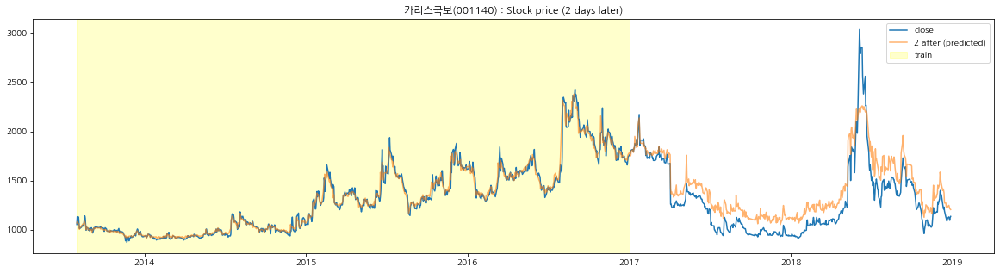

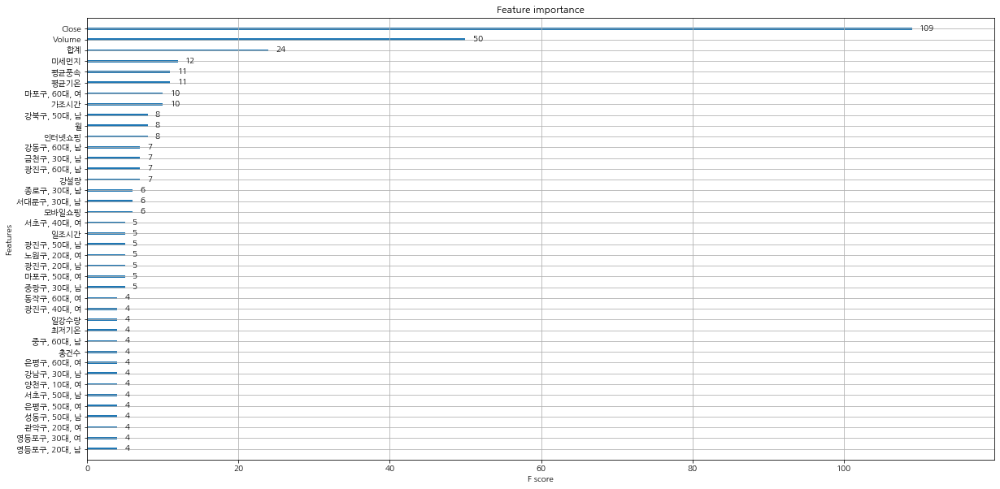

Sharpe Ratio :  0.09576200180023478
Sharpe Ratio (Validation Set):  0.09576200180023478
DSR제강 069730
[12:50:49] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.9967521007069102 0.5470759525943483


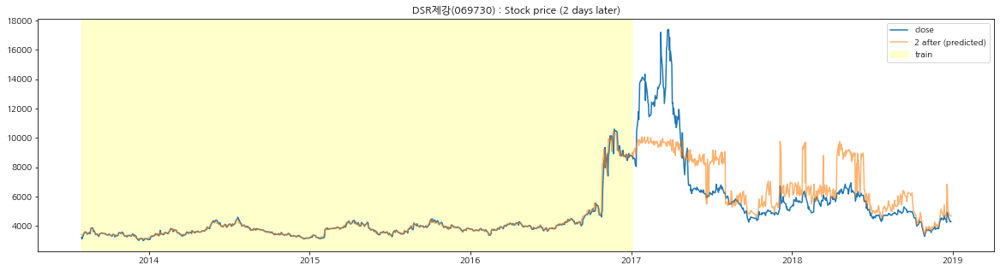

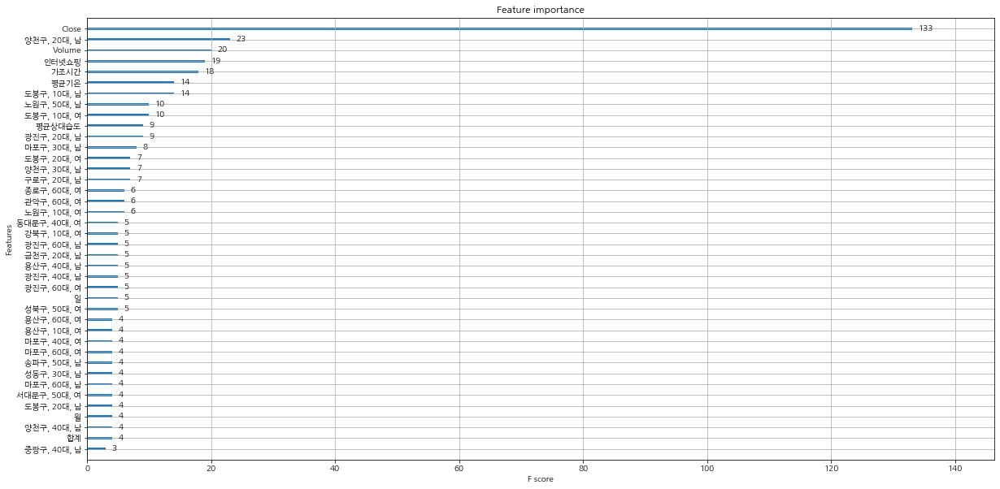

Sharpe Ratio :  0.04832150701411357
Sharpe Ratio (Validation Set):  0.04832150701411357
이화산업 000760
[12:50:52] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.9926337597638372 0.7923127011558078


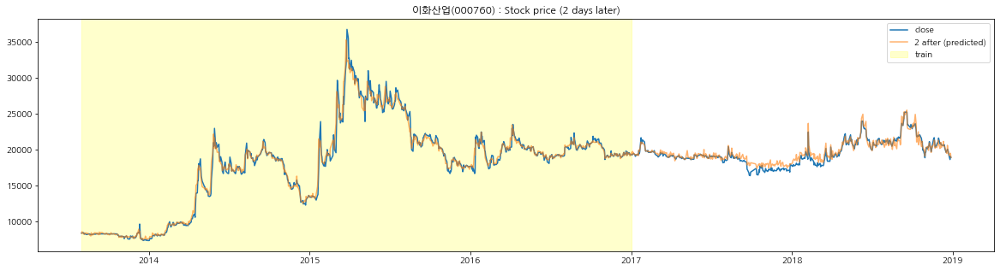

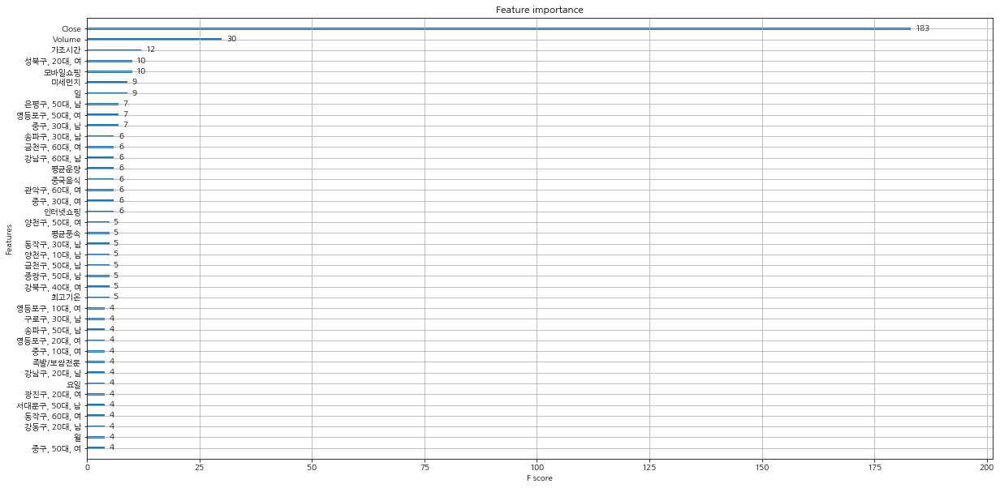

Sharpe Ratio :  -2
Sharpe Ratio (Validation Set):  -2
형지엘리트 093240
[12:50:55] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.9965243271506605 0.5117677351724175


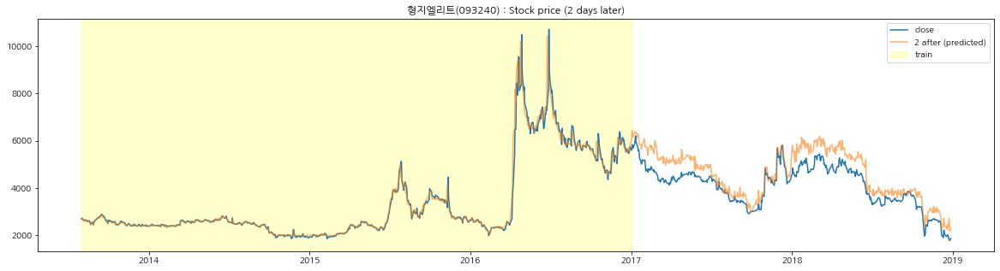

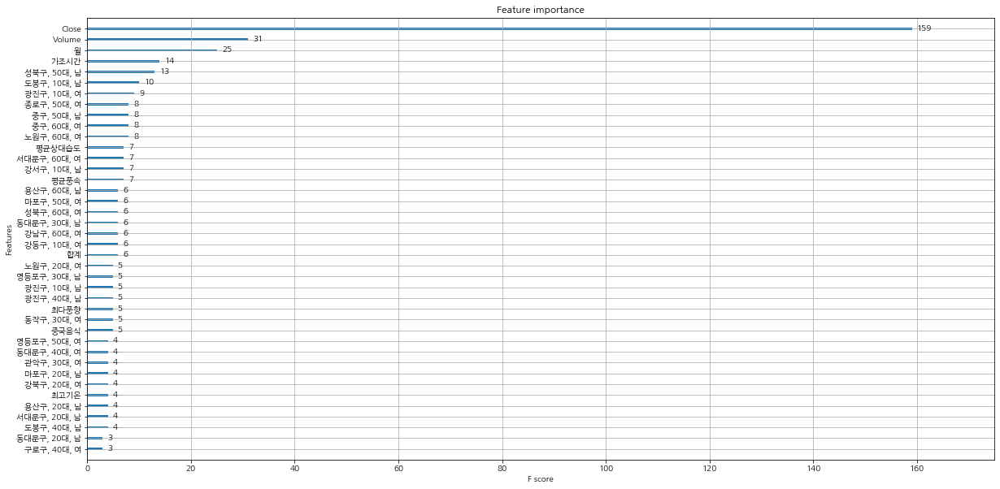

Sharpe Ratio :  0.06983727939649262
Sharpe Ratio (Validation Set):  0.06983727939649262
한국주철관공업 000970
[12:50:58] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.9970019611704475 0.7606473761795876


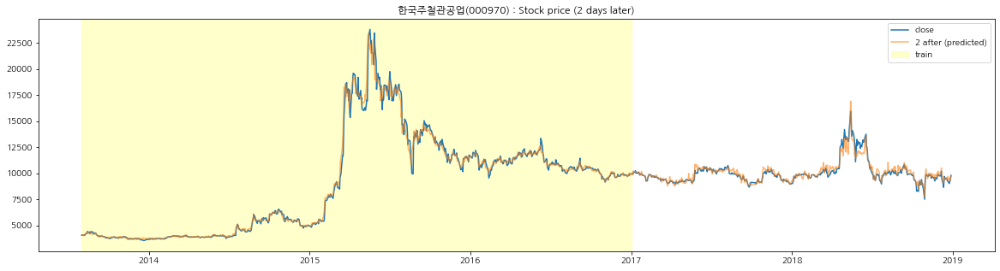

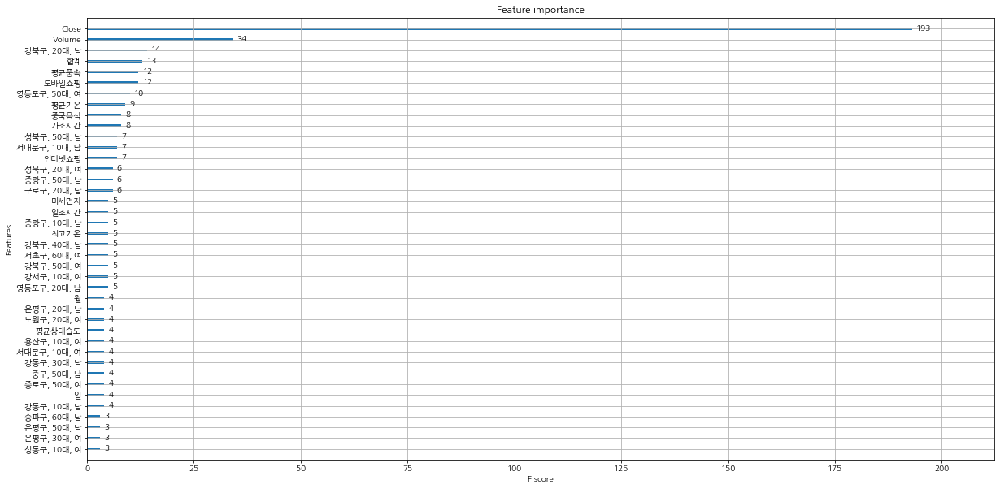

Sharpe Ratio :  -2
Sharpe Ratio (Validation Set):  -2
모나리자 012690
[12:51:01] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.9938889433810265 0.8125734966954731


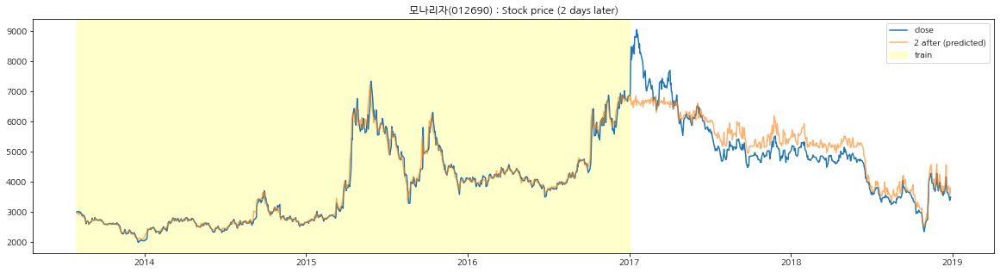

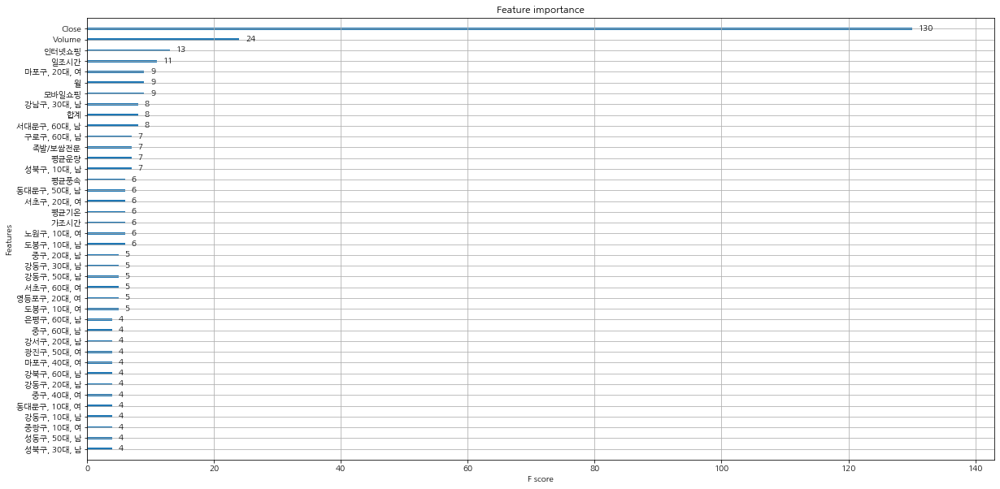

Sharpe Ratio :  0.06884801883083105
Sharpe Ratio (Validation Set):  0.06884801883083105
우리들휴브레인 118000
[12:51:04] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.99735702109188 0.9213541596225421


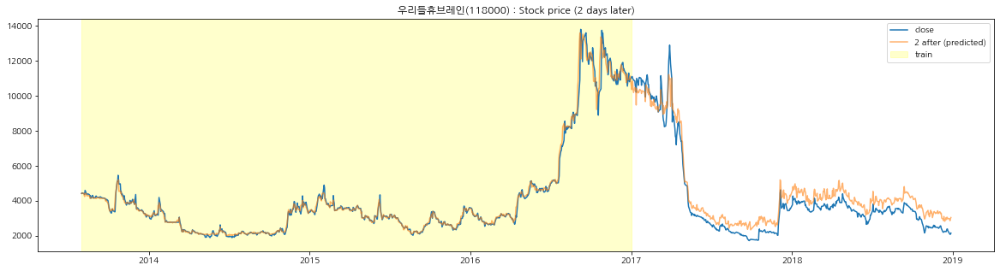

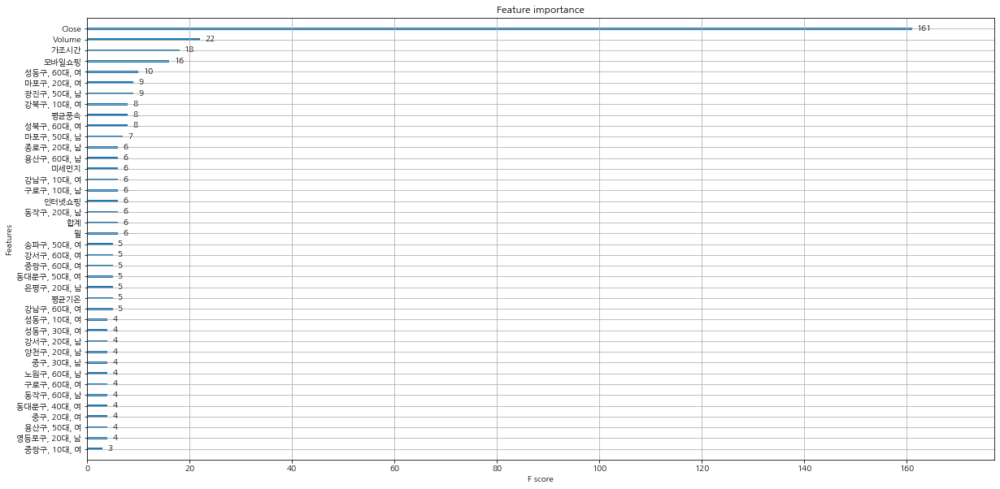

Sharpe Ratio :  0.0283940554400112
Sharpe Ratio (Validation Set):  0.0283940554400112
대창 012800
[12:51:08] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.9667420936709181 0.7773068583051976


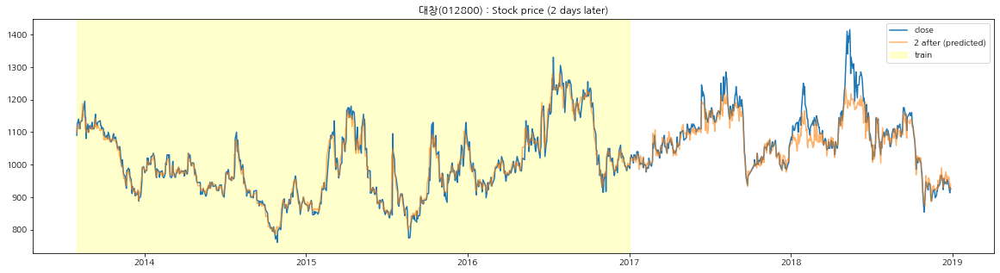

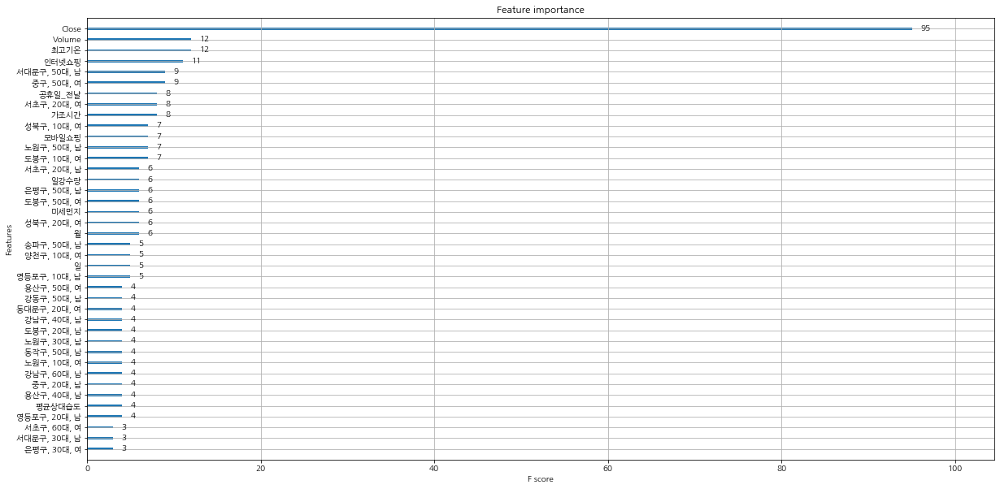

Sharpe Ratio :  0.09622483428133535
Sharpe Ratio (Validation Set):  0.09622483428133535
케이탑리츠 145270
[12:51:11] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.9954226648315528 0.7868503965882498


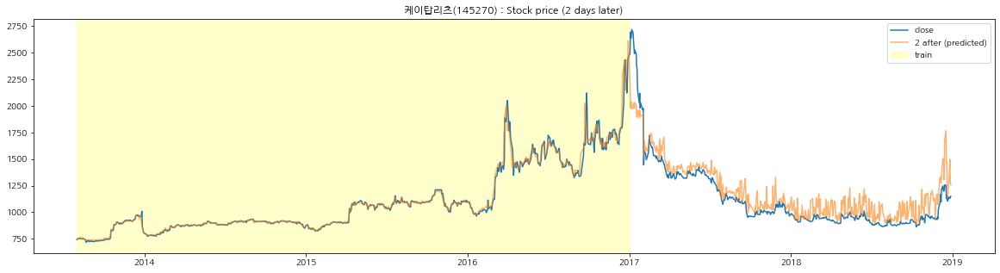

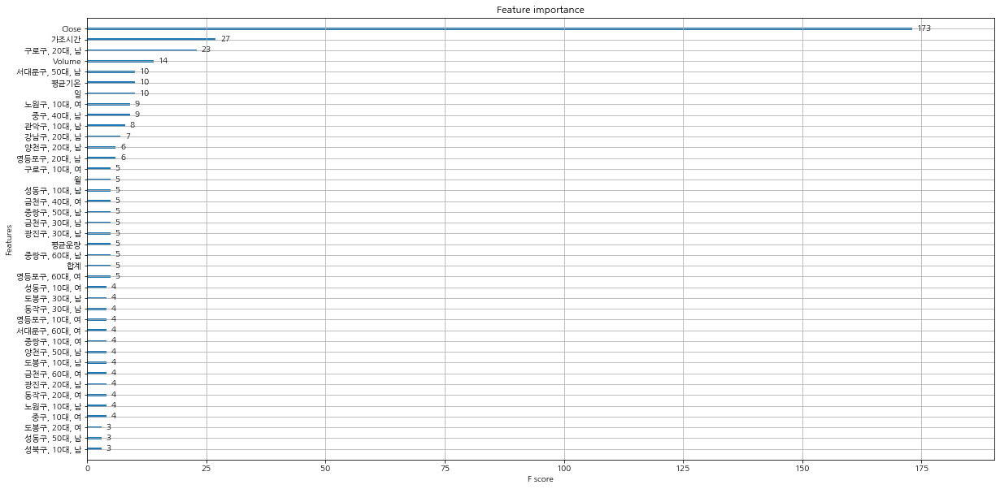

Sharpe Ratio :  0.08601896345485771
Sharpe Ratio (Validation Set):  0.08601896345485771
한국주강 025890
[12:51:14] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.980943957439536 0.3183056898191877


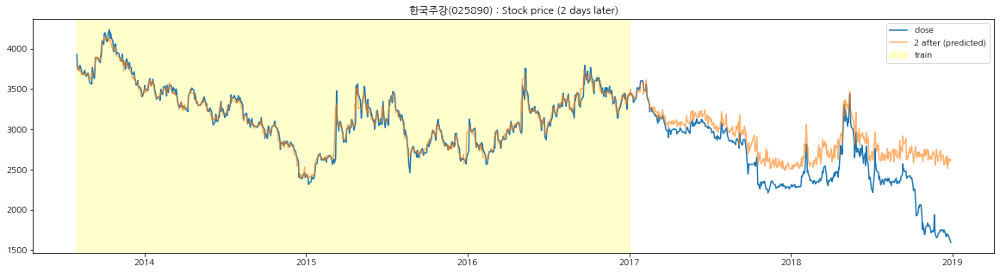

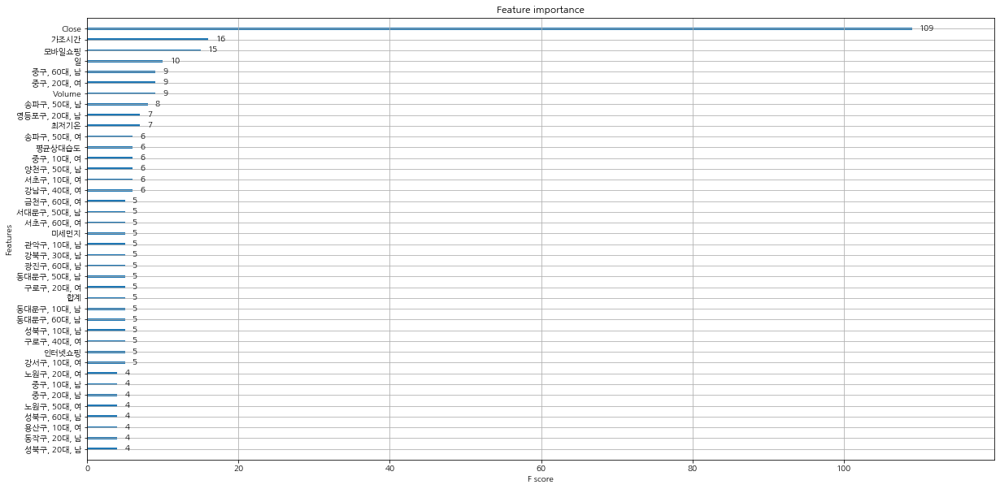

Sharpe Ratio :  0.061424068987803546
Sharpe Ratio (Validation Set):  0.061424068987803546
샘표 007540
[12:51:17] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.996840210006155 0.392143539384318


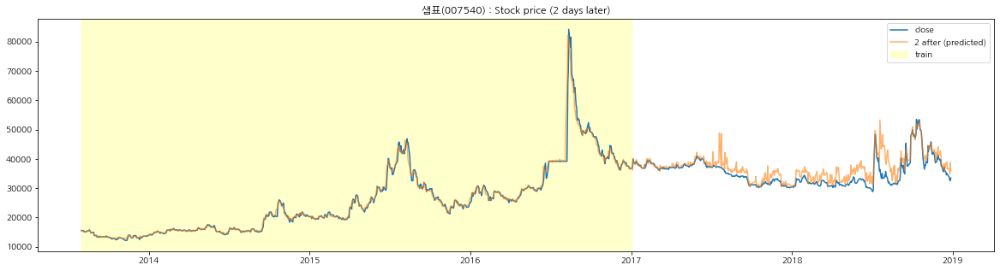

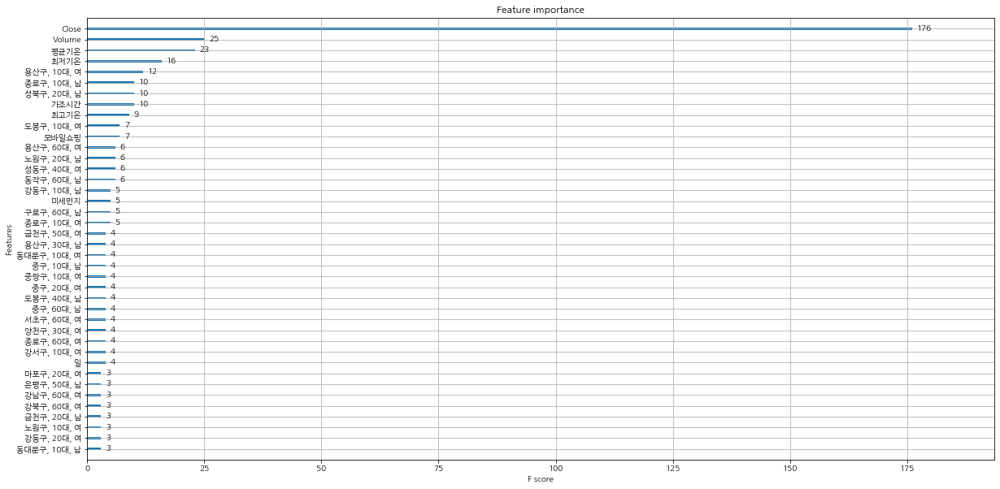

Sharpe Ratio :  0.05732721633275494
Sharpe Ratio (Validation Set):  0.05732721633275494
일진전기 103590
[12:51:20] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.9928803295173855 0.677785358672601


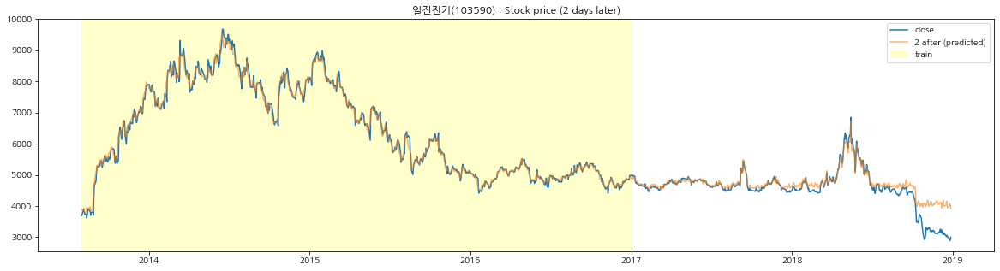

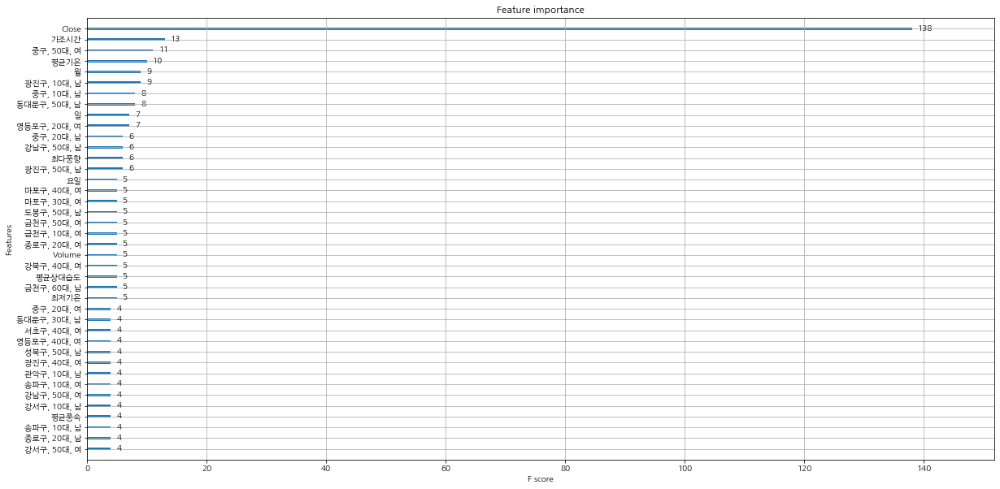

Sharpe Ratio :  0.08014129928743427
Sharpe Ratio (Validation Set):  0.08014129928743427
삼부토건 001470
[12:51:23] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.9945125722512185 -1.7280375551567242


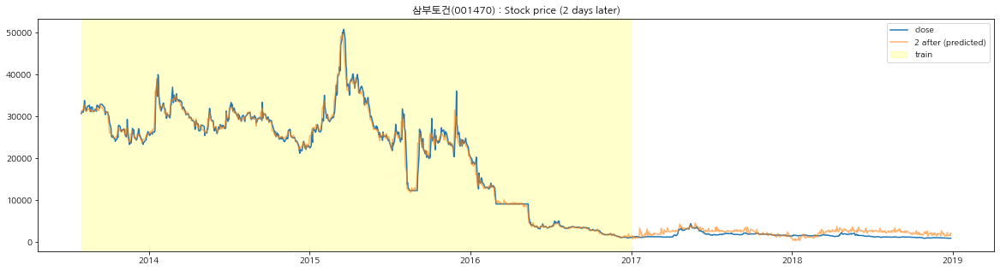

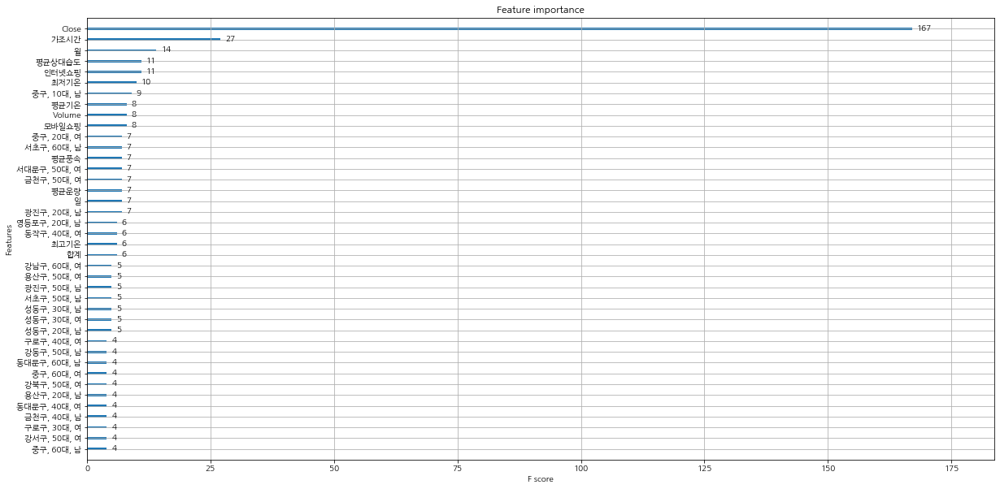

Sharpe Ratio :  0.026963437113958506
Sharpe Ratio (Validation Set):  0.026963437113958506
GS글로벌 001250
[12:51:27] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.9982019520849167 0.6771062906265325


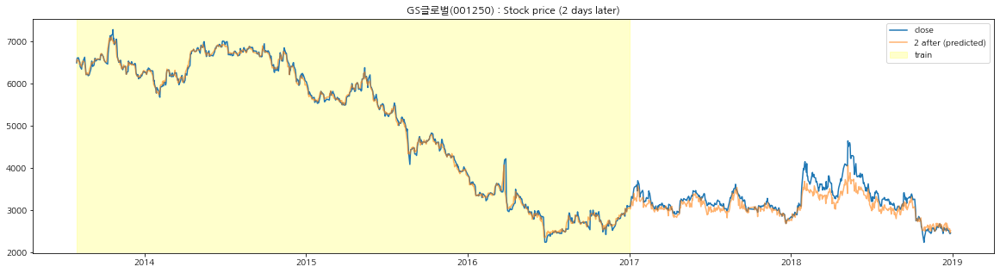

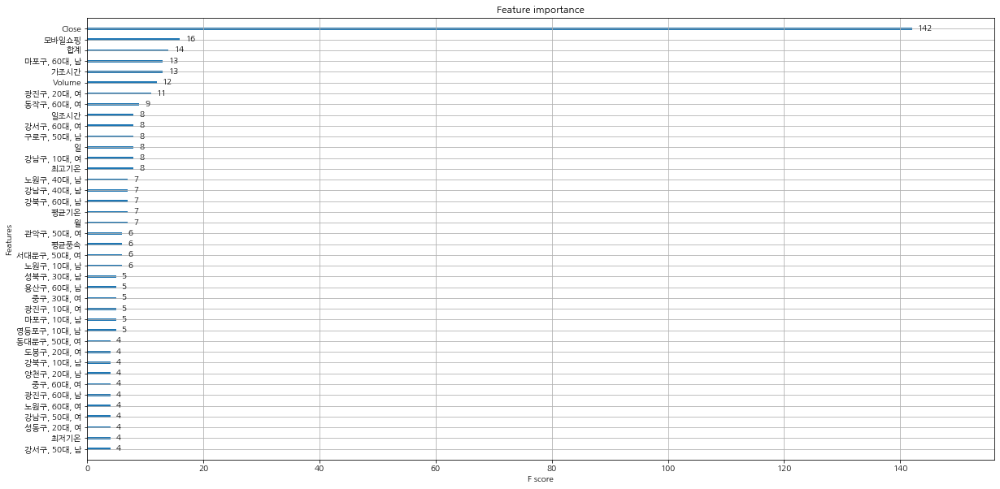

Sharpe Ratio :  0.06661903039002258
Sharpe Ratio (Validation Set):  0.06661903039002258
유니온 000910
[12:51:30] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.9762222798013028 0.7810580709196674


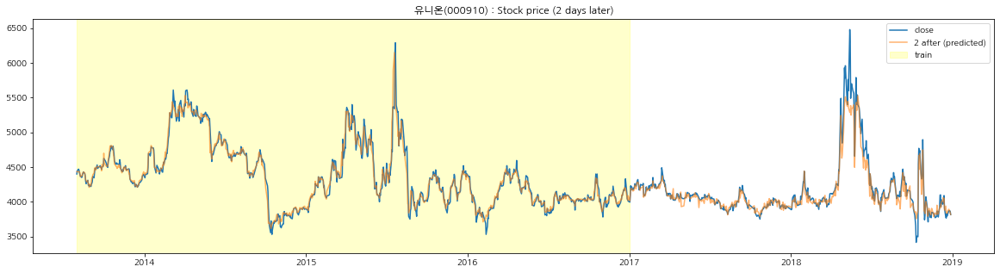

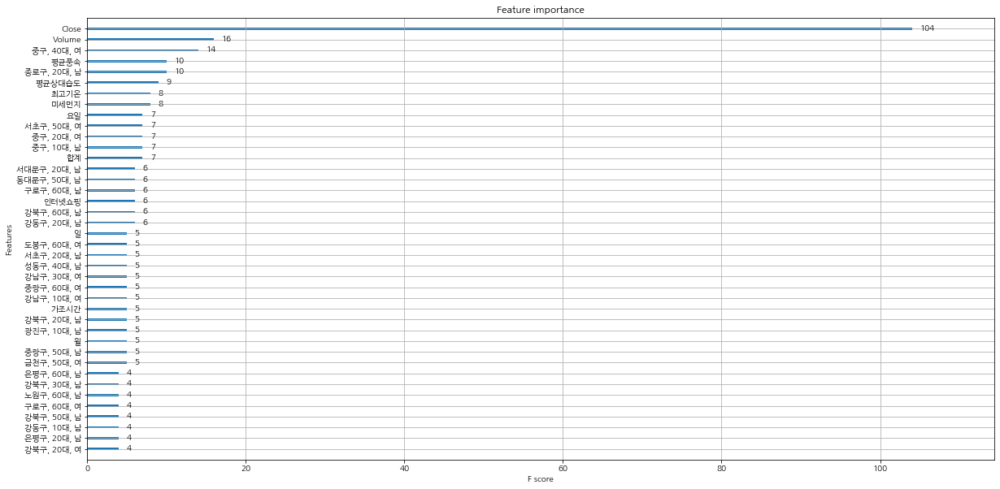

Sharpe Ratio :  0.052804644993657154
Sharpe Ratio (Validation Set):  0.052804644993657154
유엔젤 072130
[12:51:33] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.9853910546600998 0.72132621945033


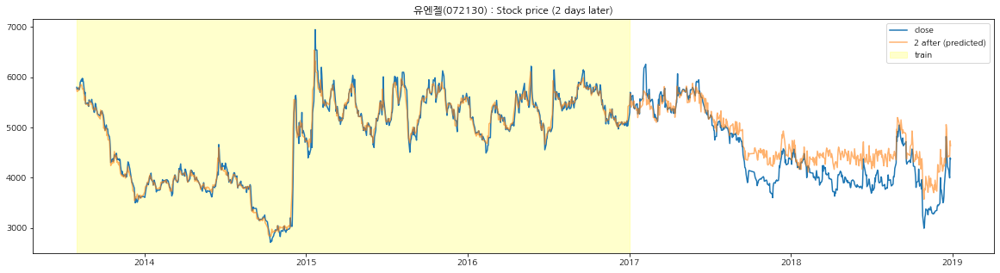

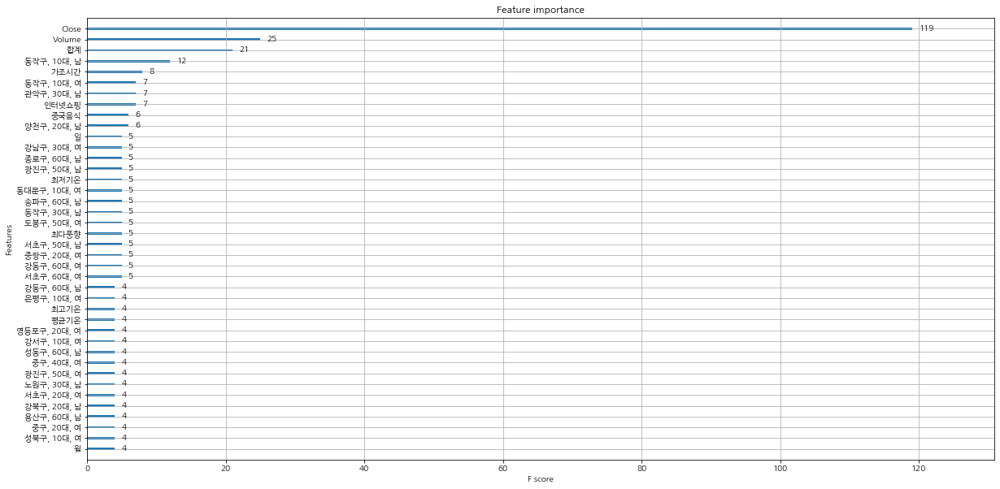

Sharpe Ratio :  0.052626114096690144
Sharpe Ratio (Validation Set):  0.052626114096690144
대양금속 009190
[12:51:36] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.989706674345816 0.7594430595303927


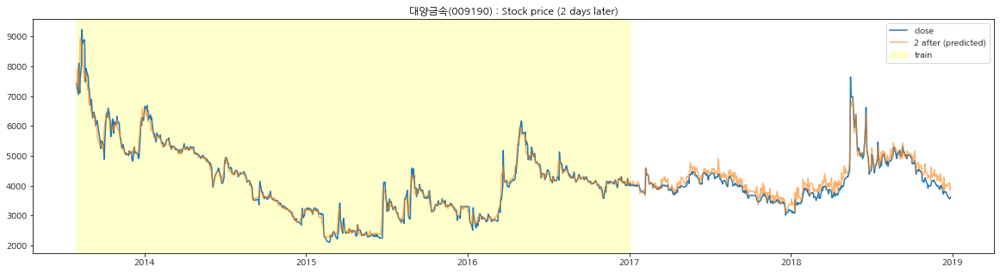

In [ ]:
df_fixed_result = pd.DataFrame(columns=column_name)
display(df_fixed_result)

for idx_ticker in range(target_mtd.shape[0]) : 
    try : 
        ticker = stocks_target['코드'][idx_ticker]
        company_name = stocks_target['기업명'][idx_ticker]
        print('%s %s' % (company_name, ticker))

        # 2. Inference with Best Hyperparameter given from step 1
        time_shift = -2
        target_profit = 0
        days_to_hold = 2
        
        df = load_data(ticker)
        df, x, y, others, x_train, x_valid, y_train, y_valid, others_train, others_valid, x_columns = split_data(df, time_shift)
        data_train, data_valid = run_model(df, others, others_train, others_valid, x_train, y_train, x_valid, y_valid, time_shift, x_columns, visualize=True)

        global target_profit_global
        target_profit_global = target_profit
        global days_to_hold_global
        days_to_hold_global = days_to_hold

        bt = Backtest(data_valid, Str, cash=10000000000, commission=0)
        result = bt.run()
        bt.plot()

        value = result['Sharpe Ratio']
        if np.isnan(value) : 
            value = -2
        print('Sharpe Ratio : ', value)
        
        print('Sharpe Ratio (Validation Set): ', value)
        df_fixed_result.loc[idx_ticker] = pd.DataFrame(result).T.values[0]
    except Exception as e :
        print(e)
        